In [1]:
from sz_utils import data_handler, preprocess
import sz_utils
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport

In [2]:
# no limint columns and rows
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [3]:
patients = data_handler.get_patients()
patients[14]

'chb15'

In [4]:
data = data_handler.get_seizure_data(patients[14])
# data

In [5]:
edf = data_handler.get_patient_edf(patients[14])

In [9]:
%%capture
dataa = data_handler.get_edf_data(patients[14], edf[0])

In [10]:
dataa.head()

,time,FP1-F7,F7-T7,T7-P7,P7-O1,--0,FP1-F3,F3-C3,C3-P3,P3-O1,--1,FZ-CZ,CZ-PZ,--2,FP2-F4,F4-C4,C4-P4,P4-O2,--3,FP2-F8,F8-T8,T8-P8,P8-O2,--4,FC1-Ref,FC2-Ref,FC5-Ref,FC6-Ref,CP1-Ref,CP2-Ref,CP5-Ref,CP6-Ref
0,0.000000,-9.279609,-23.931624,-26.862027,168.498168,-1.0,52.258852,-36.630037,121.611722,-28.815629,-1.0,-29.79243,-26.862027,-1.0,18.070818,-167.521368,-48.351648,159.70696,-1.0,1.465201,-52.258852,36.630037,-23.931624,-1.0,-47.374847,74.725275,98.168498,3.418803,-66.910867,41.514042,-3.418803,-3.418803
1,0.003906,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.48840,0.488400,-1.0,0.488400,0.488400,0.488400,0.48840,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400
2,0.007812,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.48840,0.488400,-1.0,0.488400,0.488400,0.488400,0.48840,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400
3,0.011719,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.48840,0.488400,-1.0,0.488400,0.488400,0.488400,0.48840,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400
4,0.015625,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.48840,0.488400,-1.0,0.488400,0.488400,0.488400,0.48840,-1.0,0.488400,0.488400,0.488400,0.488400,-1.0,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400,0.488400


In [10]:
dataa.shape

(922112, 32)

In [17]:
list_features = ['time','FP1-F7', 'F7-T7', 'T7-P7', 'P7-O1', 'FP1-F3', 'F3-C3',
 'C3-P3', 'P3-O1', 'FP2-F4', 'F4-C4', 'C4-P4', 'P4-O2', 'FP2-F8', 'F8-T8',
  'T8-P8-0', 'P8-O2', 'FZ-CZ', 'CZ-PZ', 'P7-T7', 'T7-FT9', 'FT9-FT10', 'FT10-T8', 'T8-P8-1']

len(list_features)

24

In [12]:
# watch the intersection of dataa.columns and list_features

columns_intersection = list(set(dataa.columns).intersection(list_features))
columns_intersection


['C3-P3',
 'F3-C3',
 'F4-C4',
 'CZ-PZ',
 'P3-O1',
 'P4-O2',
 'FP1-F7',
 'F8-T8',
 'T7-P7',
 'P8-O2',
 'time',
 'F7-T7',
 'FP1-F3',
 'FZ-CZ',
 'FP2-F8',
 'FP2-F4',
 'C4-P4',
 'P7-O1']

In [16]:
len(columns_intersection)

18

In [13]:
df = dataa[columns_intersection]

In [15]:
df.sample(3)

,C3-P3,F3-C3,F4-C4,CZ-PZ,P3-O1,P4-O2,FP1-F7,F8-T8,T7-P7,P8-O2,time,F7-T7,FP1-F3,FZ-CZ,FP2-F8,FP2-F4,C4-P4,P7-O1
576792,-10.256410,-0.488400,-25.885226,-25.885226,-17.094017,0.488400,-4.395604,-11.233211,-10.256410,2.442002,2253.093750,-3.418803,-5.372405,-9.279609,3.418803,11.233211,-11.233211,-16.117216
197076,-8.302808,-1.465201,-2.442002,-2.442002,-9.279609,-9.279609,-7.326007,0.488400,-4.395604,-22.954823,769.828125,-8.302808,-9.279609,-12.210012,0.488400,-0.488400,-7.326007,-8.302808
216278,0.488400,3.418803,6.349206,13.186813,4.395604,3.418803,6.349206,0.488400,2.442002,-0.488400,844.835938,-8.302808,0.488400,0.488400,0.488400,-0.488400,1.465201,5.372405


In [ ]:
%%capture

prof = ProfileReport(df)
prof.to_file(output_file='chb15.html')

In [ ]:
profile_report.to_widgets()

In [18]:
profile = ProfileReport(df)

profile.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
prof = ProfileReport(df)
prof.to_file(output_file='chb15.json')

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\multimethod\__init__.py:312: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\scipy\stats\_stats_py.py:5215: RuntimeWarning: overflow encountered in longlong_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


Render JSON:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
profile_report = df.profile_report(html={"style": {"full_width": True}})
profile_report.to_file("example.html")

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\multimethod\__init__.py:312: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\scipy\stats\_stats_py.py:5215: RuntimeWarning: overflow encountered in longlong_scalars
  (2 * xtie * ytie) / m + x0 * y0 / (9 * m * (size - 2)))


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [21]:
profile = ProfileReport(df, minimal=True)
profile.to_file("output.html")

c:\Users\crist\miniconda3\envs\gpu_base\lib\site-packages\multimethod\__init__.py:312: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return func(*args, **kwargs)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

array([<AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >,
       <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >,
       <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >,
       <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >, <AxesSubplot: >,
       <AxesSubplot: >, <AxesSubplot: >], dtype=object)

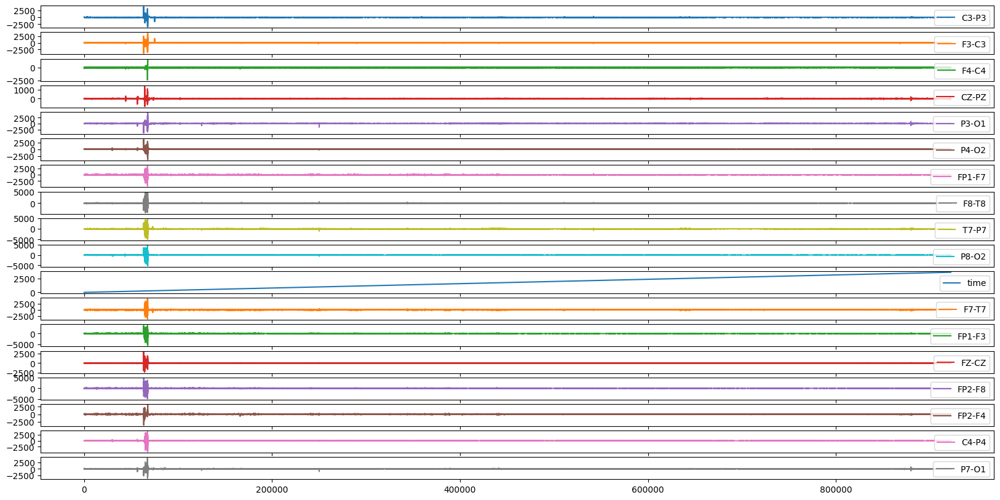

In [24]:
import matplotlib.pyplot as plt
df = df.drop(columns=['time'])
df.plot(subplots=True, figsize=(20, 10))
plt.show()

<AxesSubplot: >

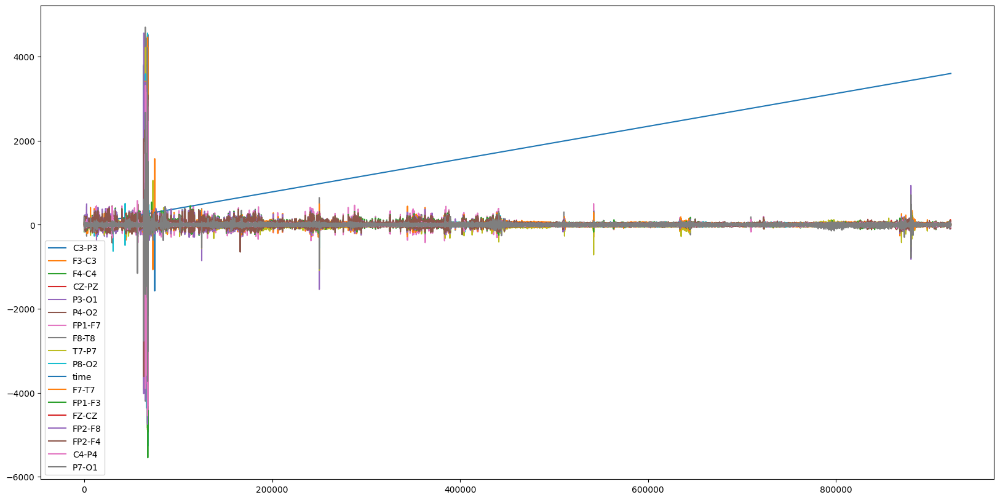

In [25]:
df.plot(figsize=(20, 10))